In [2]:
import plotly.express as px
import pandas as pd
import numpy as np
import ast
import re

import matplotlib.pyplot as plt

In [3]:
# Convert the messy dataformat to arrays
def convert_to_numpy_array(data):
    if isinstance(data, str):
        # Remove newline characters
        cleaned_data = data.replace('\n', '')
        # Split the string into individual array representations
        array_strings = re.findall(r'array\((\[.*?\])\)', cleaned_data)
        arrays = []
        for arr_str in array_strings:
            # Clean the array string and convert to NumPy array
            clean_arr_str = re.sub(r'(dtype=object|[\[\]])', '', arr_str)
            numbers = re.findall(r'[\d\.\+\-e]+', clean_arr_str)
            try:
                arrays.append(np.array([float(num) for num in numbers]))
            except ValueError as e:
                # Handle any parsing errors
                print(f"Error converting string to float: {e}")
                print(f"Problematic string: {arr_str}")
        return arrays
    else:
        # Handle non-string data (like empty lists)
        return data

In [108]:
def plot_countryidps(scenario):
    df = results[scenario]["country_data"]
    df["idps"] = df["idps"].astype(int)
    df['idp_cum'] = df.groupby(level='AgentID')['idps'].cumsum()
    df = df.reset_index()
    df = df.rename(columns={"AgentID":"Country"})
    # Problem with Turkey one year
    df["GDP_pc"] = df["GDP"] / df["Population"]
    fig = px.scatter(df, x="GDP_pc", y="idp_cum", animation_frame="Step", animation_group="Country",
            size="Population",color="Region", hover_name="Country",
            log_x=True,log_y=True, size_max=55, range_x=[df["GDP_pc"].min(),df["GDP_pc"].max()*1.10], range_y=[1000,df["idp_cum"].max()*1.10])

    fig.update_layout(title = scenario+" Internally Displaced People",width=2000, height=1000)
    fig.show()
    return

In [116]:
def plot_regionidps(scenario):
    df = results[scenario]["country_data"]
    df["idps"] = df["idps"].astype(int)
    df['idp_cum'] = df.groupby(level='AgentID')['idps'].cumsum()
    df = df.groupby(['Step', 'Region']).agg({
                                        'idp_cum': 'sum',
                                        'GDP': 'sum',
                                        'Population': 'sum'
                                        }).reset_index()
    # Problem with Turkey one year
    df["GDP_pc"] = df["GDP"] / df["Population"]
    fig = px.bar(df, x="Region", y="idp_cum", color="Region",
        animation_frame="Step", range_y=[0,df["idp_cum"].max()*1.10])

    fig.update_layout(title = scenario+" Internally Displaced People",width=2000, height=1000)
    fig.show()
    return


In [5]:
country_regions = pd.read_csv("data/model_params/countries_regions.csv")

countries = country_regions["Country"].unique()
regions = country_regions["Region"].unique()

In [48]:
scenarios = ["SSP119", "SSP126", "SSP245", "SSP370", "SSP585"]
results = {}
for scenario in scenarios:
    print("Loading ",scenario)
    try:
        model_data = pd.read_csv("data/output/"+scenario+"/model_data.csv")
        country_data = pd.read_csv("data/output/"+scenario+"/country_data.csv")
        results[scenario] = {"model_data":model_data, "country_data":country_data}
        results[scenario]["country_data"]["Floods"] = results[scenario]["country_data"]["Floods"].apply(convert_to_numpy_array)
        results[scenario]["country_data"]["Storms"] = results[scenario]["country_data"]["Storms"].apply(convert_to_numpy_array)
        results[scenario]["model_data"]["Floods"] = results[scenario]["model_data"]["Floods"].apply(ast.literal_eval)
        results[scenario]["model_data"]["Storms"] = results[scenario]["model_data"]["Storms"].apply(ast.literal_eval)

        #Remove columns
        results[scenario]["model_data"] = results[scenario]["model_data"].drop(columns='Unnamed: 0',axis=1)
        results[scenario]["model_data"].index = results[scenario]["model_data"].index + 2021
        results[scenario]["model_data"].index.name = "Year"
        results[scenario]["country_data"]["Step"] = results[scenario]["country_data"]["Step"] + 2020
        results[scenario]["country_data"].set_index(["Step", "AgentID"],inplace=True)
        results[scenario]["country_data"].index = country_data.index.set_levels(countries,level="AgentID")
        
    except:
        print("No data for scenario ",scenario)
    
#Problem with disaster durations due to the Weibull distribution being too extreme which cause a huge number of displacements
for scenario in scenarios[:-1]:
    for year in range(2021, 2301):  # Assuming years range from 2021 to 2300
        if year > 2021:  # Skip the first year since it has no previous year
            current_idps = results[scenario]["model_data"].at[year, 'Floods']['idps']
            if int(current_idps) > 5_000_000_000.0:
                results[scenario]["model_data"].at[year, 'Floods'] = results[scenario]["model_data"].at[year - 1, 'Floods']
            current_idps = results[scenario]["model_data"].at[year, 'Storms']['idps']
            if int(current_idps) > 5_000_000_000.0:
                results[scenario]["model_data"].at[year, 'Storms'] = results[scenario]["model_data"].at[year - 1, 'Storms']

            for country in countries:
                current_idps_total = results[scenario]["country_data"].at[(year,country), 'idps']
                if int(current_idps_total) > 5_000_000_000.0:
                    results[scenario]["country_data"].at[(year,country), 'idps'] = results[scenario]["country_data"].at[(year - 1,country), 'idps']
                
                current_idps_total = results[scenario]["country_data"].at[(year,country), "idps"]
                if int(current_idps_total) > 5_000_000_000.0:
                    # Set to the previous year's idps value
                    results[scenario]["country_data"].at[(year,country), 'idps'] = results[scenario]["country_data"].at[(year - 1,country), 'idps']

                current_pop = results[scenario]["country_data"].at[(year,country),"Population"]
                if int(current_pop) < 0:
                    results[scenario]["country_data"].at[(year,country), 'Population'] = results[scenario]["country_data"].at[(year - 1,country), 'Population']
                    
    results[scenario]["country_data"]["Population"] = results[scenario]["country_data"]["Population"].astype(int)


Loading  SSP119
Loading  SSP126
Loading  SSP245
Loading  SSP370
Loading  SSP585
No data for scenario  SSP585


In [68]:
for scenario in scenarios[:-1]:
    dfc = results[scenario]["country_data"]
    dfc['idp_cum'] = dfc.groupby(level='AgentID')['idps'].cumsum()
    total_idp = dfc.xs(2300,level="Step")["idp_cum"].sum()
    dfm = results[scenario]["model_data"]
    floods = dfm["Floods"].apply(pd.Series)
    num_floods = floods["Num"].cumsum().iloc[-1]
    storms = dfm["Storms"].apply(pd.Series)
    num_storms = storms["Num"].cumsum().iloc[-1]
    print(f"{scenario}:")
    print(f"floods: {num_floods:,}, storms: {num_storms:,}, idps: {total_idp:,}")

SSP119:
floods: 170,826.0, storms: 89,994.0, idps: 3,751,885,888
SSP126:
floods: 226,830.0, storms: 96,618.0, idps: 3,518,697,238
SSP245:
floods: 735,288.0, storms: 157,356.0, idps: 9,199,656,770
SSP370:
floods: 36,059,070.0, storms: 815,634.0, idps: 287,224,701,553


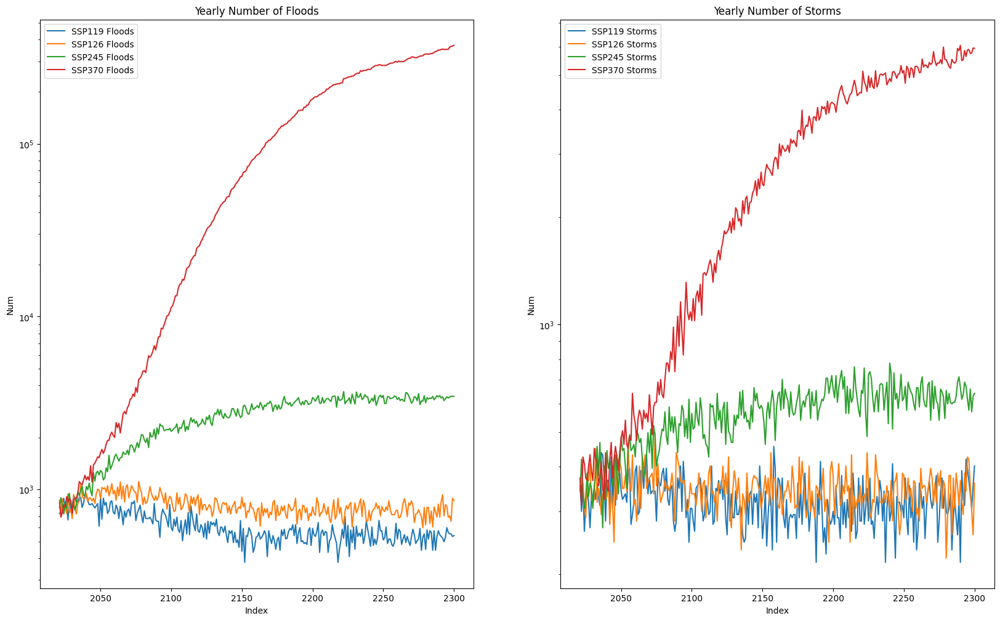

In [70]:
# Create a figure with two subplots (side by side)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 12))

# Plot for Floods
for scenario in scenarios[:-1]:
    Num_Floods = results[scenario]["model_data"]['Floods'].apply(lambda x: x['Num'] if isinstance(x, dict) else 0)
    ax1.plot(Num_Floods, label=scenario+" Floods")

ax1.set_xlabel('Index')
ax1.set_ylabel('Num')
ax1.set_title('Yearly Number of Floods')
ax1.set_yscale('log')
ax1.legend()

# Plot for Storms
for scenario in scenarios[:-1]:
    Num_Storms = results[scenario]["model_data"]["Storms"].apply(lambda x: x['Num'] if isinstance(x, dict) else 0)
    ax2.plot(Num_Storms, label=scenario+" Storms")

ax2.set_xlabel('Index')
ax2.set_ylabel('Num')
ax2.set_title('Yearly Number of Storms')
ax2.set_yscale('log')
ax2.legend()

plt.show()


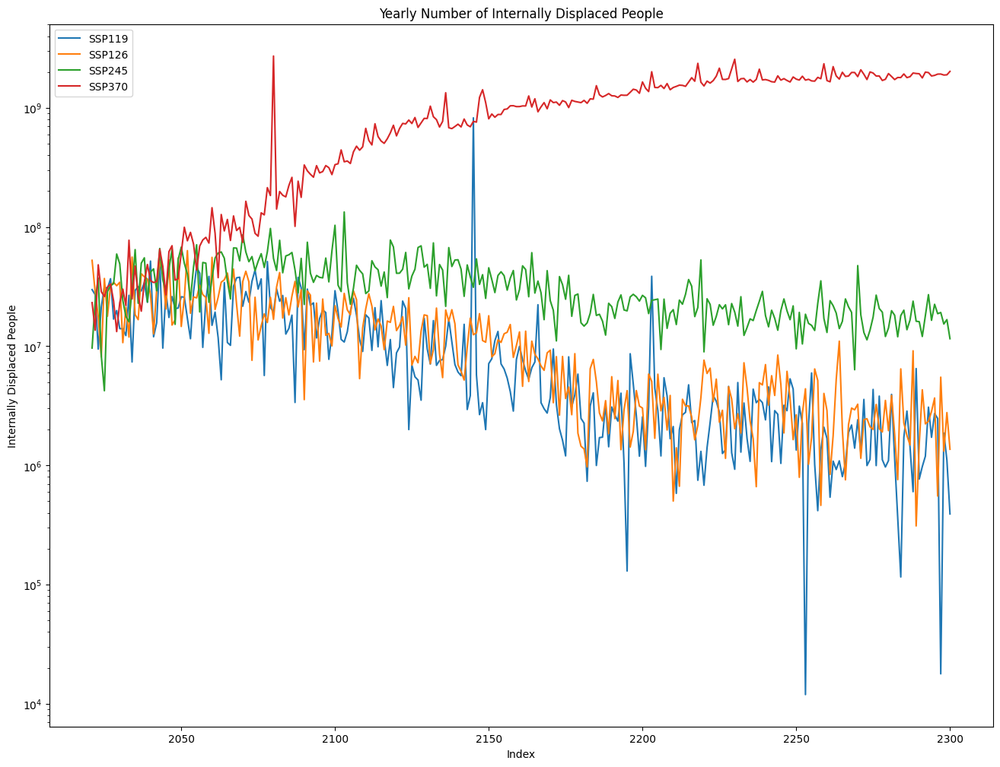

In [71]:
# Create a figure with two subplots (side by side)
plt.figure(figsize=(16,12))

# Plot for Floods
for scenario in scenarios[:-1]:
    Num_Floods = results[scenario]["model_data"]['Floods'].apply(lambda x: x['idps'] if (isinstance(x, dict)) else 0)
    Num_Storms = results[scenario]["model_data"]["Storms"].apply(lambda x: x['idps'] if (isinstance(x, dict)) else 0)
    idps = Num_Floods + Num_Storms
    plt.plot(idps, label=scenario)

plt.xlabel('Index')
plt.ylabel('Internally Displaced People')
plt.yscale('log')
plt.title("Yearly Number of Internally Displaced People")
#ax1.set_title('Number of Floods')
plt.legend()



In [110]:
plot_countryidps(scenarios[0])
plot_countryidps(scenarios[3])

In [117]:
plot_regionidps(scenarios[0])
plot_regionidps(scenarios[3])